# **ZERO TO GBMs - Final Coures Project: Health Insurance Cross sell Prediction**

###### Author: Lai Nguyen

Welcome to my Machine Learning project for the course Zero to GBMs from Jovian.ai. I'd like to take a moment to thank the instructor Aakash N S and the whole team for this awesome course, I got to learn a whole lot of ML, Linear Regression using Scikit Learn, Logestic Reasinging for Classification, Decision Trees and Random Forests, intuitives behind the Gradient Boosting with XGBoost and I appreciate them greatly for that.

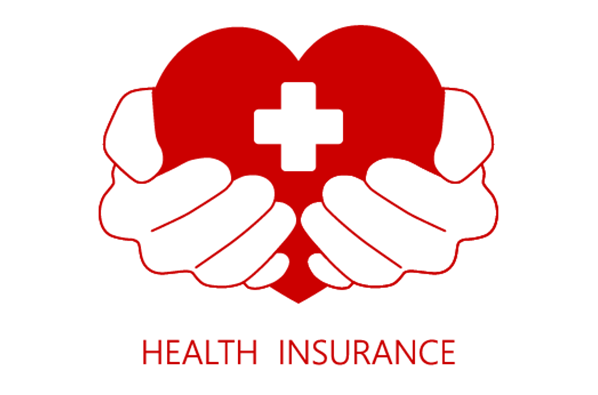

#### Problem statement:
Our client is an Insurance company that has provided Health Insurance to its customers now they need your help in building a model to predict whether the policyholders (customers) from the past year will also be interested in Vehicle Insurance provided by the company.

An insurance policy is an arrangement by which a company undertakes to provide a guarantee of compensation for specified loss, damage, illness, or death in return for the payment of a specified premium. A premium is a sum of money that the customer needs to pay regularly to an insurance company for this guarantee.

For example, you may pay a premium of Rs. 5000 each year for a health insurance cover of Rs. 200,000/- so that if God forbid, you fall ill and need to be hospitalized in that year, the insurance provider company will bear the cost of hospitalization, etc. for up to Rs. 200,000. Now if you are wondering how can the company bear such high hospitalization costs when it charges a premium of only Rs. 5000/-, that is where the concept of probabilities comes into the picture. For example, like you, there may be 100 customers who would be paying a premium of Rs. 5000 every year, but only a few of them (say 2-3) would get hospitalized that year, and not everyone. This way everyone shares the risk of everyone else.

Just like medical insurance, there is vehicle insurance where every year customer needs to pay a premium of a certain amount to insurance provider company so that in case of unfortunate accident by the vehicle, the insurance provider company will provide compensation (called ‘sum assured’) to the customer.

Building a model to predict whether a customer would be interested in Vehicle Insurance is extremely helpful for the company because it can then accordingly plan its communication strategy to reach out to those customers and optimize its business model and revenue.

Now, in order to predict, whether the customer would be interested in Vehicle insurance, you have information about demographics (gender, age, region code type), Vehicles (Vehicle Age, Damage), Policy (Premium, sourcing channel), etc.

#### Data description
**id**: Unique ID for the customer

**Gender**: Gender of the customer

**Age**: Age of the customer

**Driving_License** 0 : Customer does not have DL, 1 : Customer already has DL

**Region_Code**: Unique code for the region of the customer

**Previously_Insured** 1 : Customer already has Vehicle Insurance, 0 : Customer doesn't have Vehicle Insurance

**Vehicle_Age**: Age of the Vehicle

**Vehicle_Damage 1** : Customer got his/her vehicle damaged in the past. 0 : Customer didn't get his/her vehicle damaged in the past.

**Annual_Premium**: The amount customer needs to pay as premium in the year

**PolicySalesChannel**: Anonymized Code for the channel of outreaching to the customer ie. Different Agents, Over Mail, Over Phone, In Person, etc.

**Vintage**: Number of Days, Customer has been associated with the company

**Response** 1 : Customer is interested, 0 : Customer is not interested

# Importing necessary packages and opendatasets module to get data from Kaggle

In [9]:
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib
%matplotlib inline

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 150)
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

# Downloading the data

In [10]:
raw_train_df=pd.read_csv('data/health-insurance-cross-sell-prediction/train.csv')
raw_test_df=pd.read_csv('data/health-insurance-cross-sell-prediction/test.csv')

# Exploratory Data Analysis

In [11]:
raw_train_df

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,1,Male,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,2,Male,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,3,Male,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,4,Male,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,5,Female,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0
...,...,...,...,...,...,...,...,...,...,...,...,...
381104,381105,Male,74,1,26.0,1,1-2 Year,No,30170.0,26.0,88,0
381105,381106,Male,30,1,37.0,1,< 1 Year,No,40016.0,152.0,131,0
381106,381107,Male,21,1,30.0,1,< 1 Year,No,35118.0,160.0,161,0
381107,381108,Female,68,1,14.0,0,> 2 Years,Yes,44617.0,124.0,74,0


In [12]:
raw_test_df

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage
0,381110,Male,25,1,11.0,1,< 1 Year,No,35786.0,152.0,53
1,381111,Male,40,1,28.0,0,1-2 Year,Yes,33762.0,7.0,111
2,381112,Male,47,1,28.0,0,1-2 Year,Yes,40050.0,124.0,199
3,381113,Male,24,1,27.0,1,< 1 Year,Yes,37356.0,152.0,187
4,381114,Male,27,1,28.0,1,< 1 Year,No,59097.0,152.0,297
...,...,...,...,...,...,...,...,...,...,...,...
127032,508142,Female,26,1,37.0,1,< 1 Year,No,30867.0,152.0,56
127033,508143,Female,38,1,28.0,0,1-2 Year,Yes,28700.0,122.0,165
127034,508144,Male,21,1,46.0,1,< 1 Year,No,29802.0,152.0,74
127035,508145,Male,71,1,28.0,1,1-2 Year,No,62875.0,26.0,265


In [13]:
raw_train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 381109 entries, 0 to 381108
Data columns (total 12 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    381109 non-null  int64  
 1   Gender                381109 non-null  object 
 2   Age                   381109 non-null  int64  
 3   Driving_License       381109 non-null  int64  
 4   Region_Code           381109 non-null  float64
 5   Previously_Insured    381109 non-null  int64  
 6   Vehicle_Age           381109 non-null  object 
 7   Vehicle_Damage        381109 non-null  object 
 8   Annual_Premium        381109 non-null  float64
 9   Policy_Sales_Channel  381109 non-null  float64
 10  Vintage               381109 non-null  int64  
 11  Response              381109 non-null  int64  
dtypes: float64(3), int64(6), object(3)
memory usage: 34.9+ MB


In [14]:
raw_test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 127037 entries, 0 to 127036
Data columns (total 11 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    127037 non-null  int64  
 1   Gender                127037 non-null  object 
 2   Age                   127037 non-null  int64  
 3   Driving_License       127037 non-null  int64  
 4   Region_Code           127037 non-null  float64
 5   Previously_Insured    127037 non-null  int64  
 6   Vehicle_Age           127037 non-null  object 
 7   Vehicle_Damage        127037 non-null  object 
 8   Annual_Premium        127037 non-null  float64
 9   Policy_Sales_Channel  127037 non-null  float64
 10  Vintage               127037 non-null  int64  
dtypes: float64(3), int64(5), object(3)
memory usage: 10.7+ MB


In [15]:
raw_train_df.isna().sum()

id                      0
Gender                  0
Age                     0
Driving_License         0
Region_Code             0
Previously_Insured      0
Vehicle_Age             0
Vehicle_Damage          0
Annual_Premium          0
Policy_Sales_Channel    0
Vintage                 0
Response                0
dtype: int64

In [16]:
raw_train_df.isnull().sum()

id                      0
Gender                  0
Age                     0
Driving_License         0
Region_Code             0
Previously_Insured      0
Vehicle_Age             0
Vehicle_Damage          0
Annual_Premium          0
Policy_Sales_Channel    0
Vintage                 0
Response                0
dtype: int64

In [17]:
raw_test_df.isna().sum()

id                      0
Gender                  0
Age                     0
Driving_License         0
Region_Code             0
Previously_Insured      0
Vehicle_Age             0
Vehicle_Damage          0
Annual_Premium          0
Policy_Sales_Channel    0
Vintage                 0
dtype: int64

In [18]:
raw_test_df.isnull().sum()

id                      0
Gender                  0
Age                     0
Driving_License         0
Region_Code             0
Previously_Insured      0
Vehicle_Age             0
Vehicle_Damage          0
Annual_Premium          0
Policy_Sales_Channel    0
Vintage                 0
dtype: int64

As we can see, our training and test data has no missing NaN or NaN values. The data looks clear and beautiful!

In [19]:
raw_test_df.nunique()

id                      127037
Gender                       2
Age                         66
Driving_License              2
Region_Code                 53
Previously_Insured           2
Vehicle_Age                  3
Vehicle_Damage               2
Annual_Premium           36327
Policy_Sales_Channel       145
Vintage                    290
dtype: int64

Description for Numerical Columns

In [20]:
raw_train_df.describe()

,id,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response
count,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000
mean,190555.000000,38.822584,0.997869,26.388807,0.458210,30564.389581,112.034295,154.347397,0.122563
std,110016.836208,15.511611,0.046110,13.229888,0.498251,17213.155057,54.203995,83.671304,0.327936
min,1.000000,20.000000,0.000000,0.000000,0.000000,2630.000000,1.000000,10.000000,0.000000
25%,95278.000000,25.000000,1.000000,15.000000,0.000000,24405.000000,29.000000,82.000000,0.000000
50%,190555.000000,36.000000,1.000000,28.000000,0.000000,31669.000000,133.000000,154.000000,0.000000
75%,285832.000000,49.000000,1.000000,35.000000,1.000000,39400.000000,152.000000,227.000000,0.000000
max,381109.000000,85.000000,1.000000,52.000000,1.000000,540165.000000,163.000000,299.000000,1.000000


In [21]:
raw_train_df.describe(include=['object'])

,Gender,Vehicle_Age,Vehicle_Damage
count,381109,381109,381109
unique,2,3,2
top,Male,1-2 Year,Yes
freq,206089,200316,192413


# Visualization of Data

###### Gender and Response Correlation

In [22]:
fig=px.histogram(raw_train_df,
                x='Response',
                marginal='box',
                color='Gender',
                color_discrete_sequence=['blue', 'red'],
                title='Gender and Response Correlation'
                )
fig.update_layout(bargap=0.1)
fig.show()

It is noticable that Gender does not play much role in Response of the Customer and the ratio for both positive and negative response is almost equal.

##### Age and Response Correlation

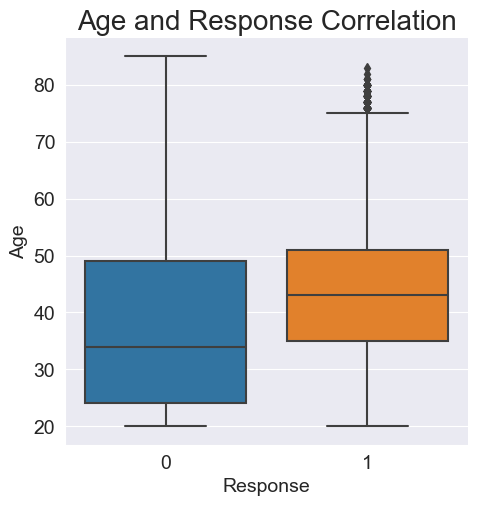

In [23]:
sns.catplot(x="Response",y="Age", data=raw_train_df, kind='box')
plt.title("Age and Response Correlation", size=20, y=1.0);

Young people (under 35) have little interest in insurance.
People over the age of 35 tend to be more interested in insurance.

###### Driving License and Response correlation  

In [24]:
fig=px.histogram(raw_train_df,
                x='Response',
                marginal='box',
                color='Driving_License',
                color_discrete_sequence=['blue', 'red'],
                title='Driving License and Response Correlation'
                )
fig.update_layout(bargap=0.1)
fig.show()

Having a driver's license doesn't play much of a role in Customer Feedback.

##### Region code and Response

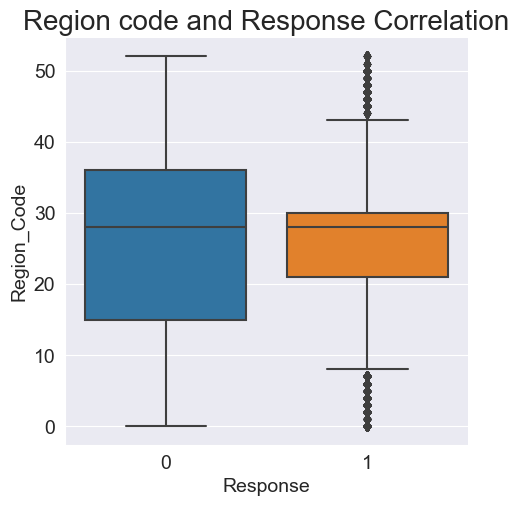

In [25]:
sns.catplot(x="Response", y="Region_Code", data=raw_train_df, kind="box")
plt.title("Region code and Response Correlation", size=20, y=1.0);

Less correlation is there between region and response.

##### Vintage and Response correlation

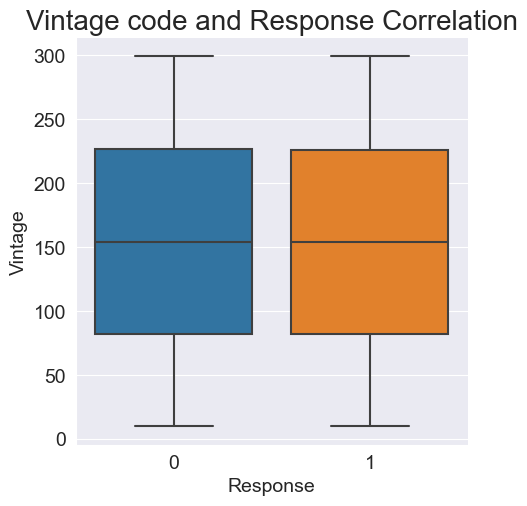

In [26]:
sns.catplot(x="Response", y="Vintage", data=raw_train_df, kind="box")
plt.title("Vintage code and Response Correlation", size=20, y=1.0);

It seems that Vintage has no effect on the response. The rate of positive and negative feedback seems to be about the same

##### Vehicle_Damage and response correlation

In [27]:
fig=px.histogram(raw_train_df,
                x='Response',
                marginal='box',
                color='Vehicle_Damage',
                color_discrete_sequence=['blue', 'red'],
                title='Vehicle_Damage and Response Correlation'
                )
fig.update_layout(bargap=0.1)
fig.show()

Damaged vehicles tend to respond positively

###### Vehicle age and Vehicle Damge

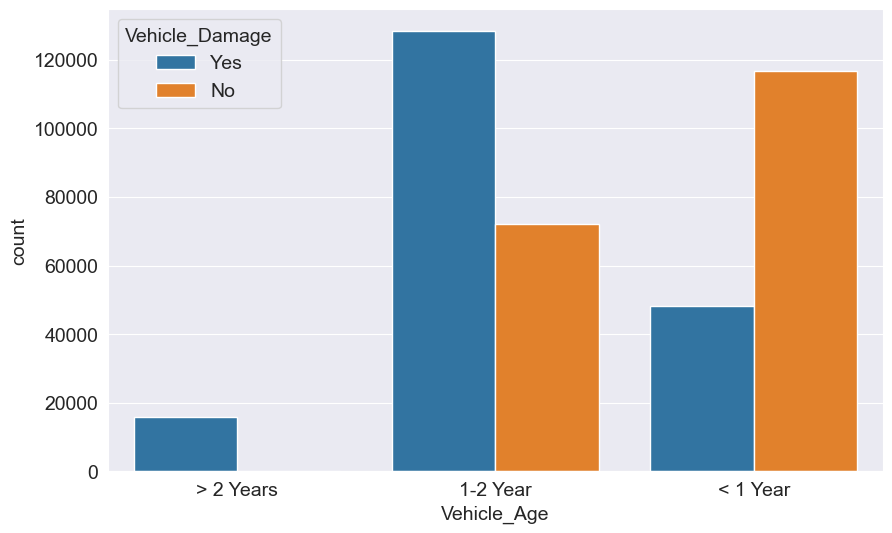

In [28]:
sns.countplot(data=raw_train_df,x='Vehicle_Age',hue='Vehicle_Damage');

In [29]:
corr_data=raw_train_df.drop(['id'], inplace=False, axis=1)

C:\Users\admin\AppData\Local\Temp\ipykernel_18740\864661940.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.

C:\Users\admin\AppData\Local\Temp\ipykernel_18740\864661940.py:3: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



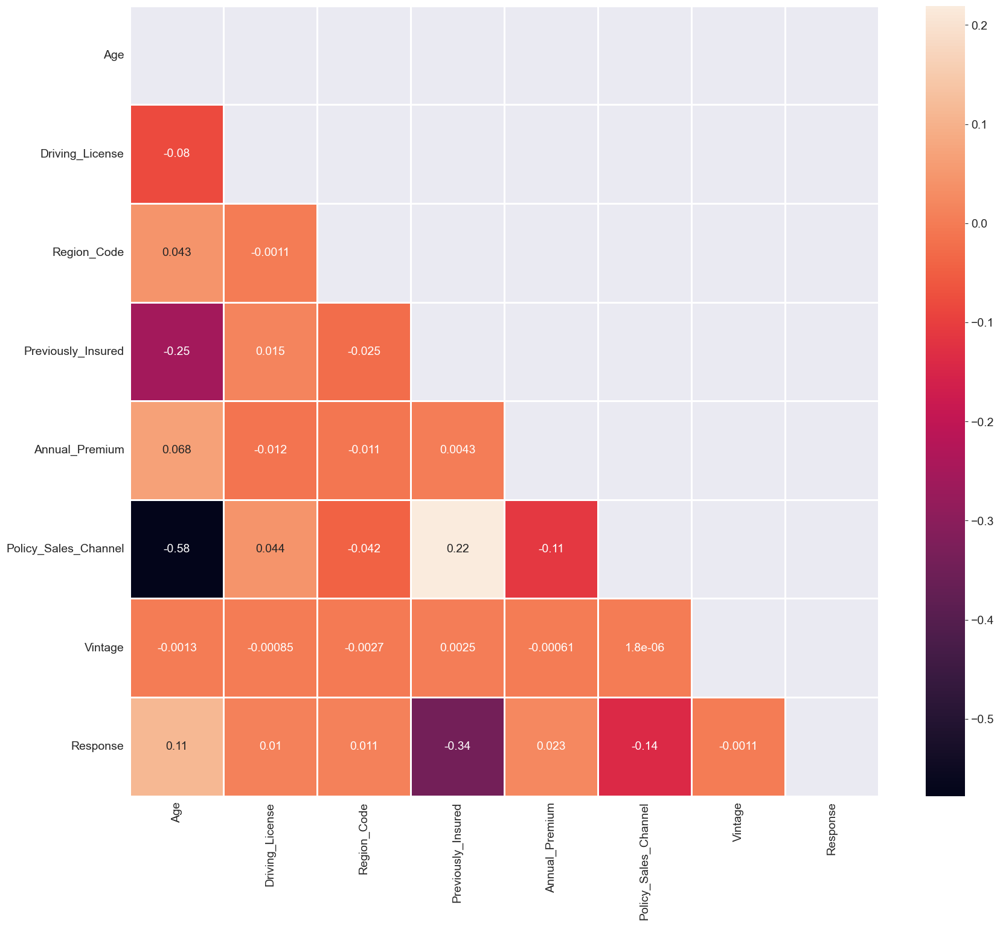

In [30]:
plt.figure(figsize=(20, 17))
matrix = np.triu(corr_data.corr())
sns.heatmap(corr_data.corr(), annot=True, linewidth=.8, mask=matrix, cmap="rocket");

This shows the entire correlation table but without the categorical columns.

# Data Preprocessing

id column that is not meaningful for the model can be removed from both training and test data.

In [31]:
raw_train_df.drop("id", inplace=True, axis=1)
raw_test_df.drop("id",inplace=True, axis=1)

##### Categorical data into numeric data with raw_train_df

In [32]:
raw_train_df['Gender']=raw_train_df['Gender'].replace({'Male':1,'Female':0})
raw_train_df.head()

,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,1,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,1,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,1,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,1,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,0,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0


In [33]:
raw_train_df['Vehicle_Age'].unique()

array(['> 2 Years', '1-2 Year', '< 1 Year'], dtype=object)

In [34]:
raw_train_df['Vehicle_Damage'].replace({'Yes':1,'No':0}, inplace=True)
raw_train_df['Vehicle_Age'].replace({'< 1 Year':1,'1-2 Year':2,'> 2 Years':3}, inplace=True)
raw_train_df.head()

,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,1,44,1,28.0,0,3,1,40454.0,26.0,217,1
1,1,76,1,3.0,0,2,0,33536.0,26.0,183,0
2,1,47,1,28.0,0,3,1,38294.0,26.0,27,1
3,1,21,1,11.0,1,1,0,28619.0,152.0,203,0
4,0,29,1,41.0,1,1,0,27496.0,152.0,39,0


Now, we already have the processed data call 'train_df'

In [35]:
train_df=raw_train_df

<AxesSubplot: >

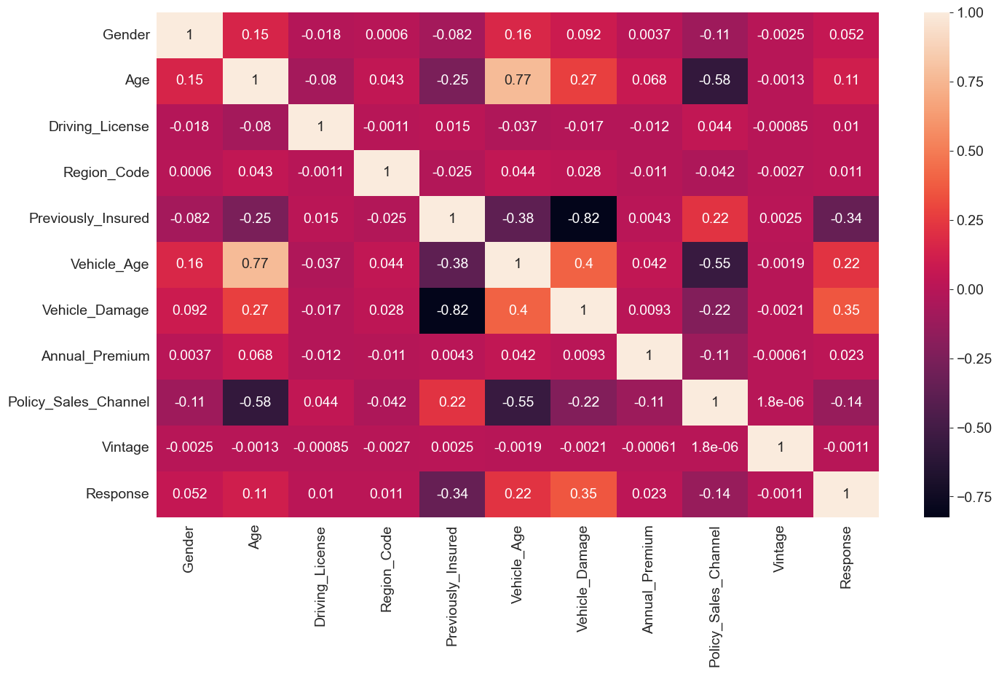

In [36]:
plt.figure(figsize=(16,9))
sns.heatmap(train_df.corr(), annot=True)

Highly correlated columns wrt to target columns which can give us better accuracy.

In [37]:
hig_corr = train_df.corr()
hig_corr_features = hig_corr.index[abs(hig_corr["Response"]) >= 0.2]
hig_corr_features

Index(['Previously_Insured', 'Vehicle_Age', 'Vehicle_Damage', 'Response'], dtype='object')

##### Categorical data into numeric data with raw_test_df

In [38]:
raw_test_df['Gender']=raw_test_df['Gender'].replace({'Male':1,'Female':0})

In [39]:
raw_test_df['Vehicle_Damage'].replace({'Yes':1,'No':0}, inplace=True)
raw_test_df['Vehicle_Age'].replace({'< 1 Year':1,'1-2 Year':2,'> 2 Years':3}, inplace=True)

Now, we already have the processed data call 'test_df'

In [40]:
test_df=raw_test_df
test_df

,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage
0,1,25,1,11.0,1,1,0,35786.0,152.0,53
1,1,40,1,28.0,0,2,1,33762.0,7.0,111
2,1,47,1,28.0,0,2,1,40050.0,124.0,199
3,1,24,1,27.0,1,1,1,37356.0,152.0,187
4,1,27,1,28.0,1,1,0,59097.0,152.0,297
...,...,...,...,...,...,...,...,...,...,...
127032,0,26,1,37.0,1,1,0,30867.0,152.0,56
127033,0,38,1,28.0,0,2,1,28700.0,122.0,165
127034,1,21,1,46.0,1,1,0,29802.0,152.0,74
127035,1,71,1,28.0,1,2,0,62875.0,26.0,265


#### Scaling Numeric Data

In [41]:
numeric_cols=['Age','Region_Code','Annual_Premium','Policy_Sales_Channel','Vintage']

In [42]:
from sklearn.preprocessing import MinMaxScaler

In [43]:
scaler=MinMaxScaler()

In [44]:
scaler.fit(train_df[numeric_cols])

MinMaxScaler()

In [45]:
train_df[numeric_cols]=scaler.transform(train_df[numeric_cols])
test_df[numeric_cols]=scaler.transform(test_df[numeric_cols])

In [46]:
train_df.describe().loc[['min', 'max']]

,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
min,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
max,1.0,1.0,1.0,1.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0


In [47]:
test_df.describe().loc[['min', 'max']]

,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage
min,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.000000,0.0,0.0
max,1.0,1.0,1.0,1.0,1.0,3.0,1.0,0.873268,1.0,1.0


In [48]:
train_df.head()

,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,1,0.369231,1,0.538462,0,3,1,0.070366,0.154321,0.716263,1
1,1,0.861538,1,0.057692,0,2,0,0.057496,0.154321,0.598616,0
2,1,0.415385,1,0.538462,0,3,1,0.066347,0.154321,0.058824,1
3,1,0.015385,1,0.211538,1,1,0,0.048348,0.932099,0.667820,0
4,0,0.138462,1,0.788462,1,1,0,0.046259,0.932099,0.100346,0


In [49]:
test_df.head()

,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage
0,1,0.076923,1,0.211538,1,1,0,0.061682,0.932099,0.148789
1,1,0.307692,1,0.538462,0,2,1,0.057916,0.037037,0.349481
2,1,0.415385,1,0.538462,0,2,1,0.069614,0.759259,0.653979
3,1,0.061538,1,0.519231,1,1,1,0.064602,0.932099,0.612457
4,1,0.107692,1,0.538462,1,1,0,0.105048,0.932099,0.993080


# Training, Validation and Test Data

In [50]:
input_cols=list(train_df.columns)[0:-1]
target_col='Response'

In [51]:
inputs=train_df[input_cols]
targets=train_df[target_col]

##### Splitting data for the training

In [52]:
from sklearn.model_selection import train_test_split

In [53]:
train_inputs, val_inputs, train_targets,val_targets=train_test_split(inputs, targets, test_size=0.2, random_state=42)

In [54]:
val_inputs.head()

,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage
200222,0,0.015385,1,0.057692,1,1,0,0.033073,0.981481,0.214533
49766,1,0.538462,1,0.288462,0,2,1,0.064866,0.154321,0.318339
172201,0,0.323077,1,0.057692,0,2,1,0.000000,0.154321,0.276817
160713,0,0.092308,1,0.211538,0,1,0,0.000000,0.925926,0.892734
53272,1,0.476923,1,0.769231,0,2,1,0.058370,0.759259,0.882353


In [55]:
len(val_inputs)

76222

In [56]:
len(val_targets)

76222

### Logistic Regression Model

In [57]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
import joblib

In [58]:
model=LogisticRegression(solver='liblinear')

In [59]:
model.fit(train_inputs, train_targets)

LogisticRegression(solver='liblinear')

In [60]:
%%time
train_preds=model.predict(train_inputs)
train_probs=model.predict_proba(train_inputs)
accuracy_score(train_targets, train_preds)

CPU times: total: 78.1 ms
Wall time: 86 ms


0.8779154244031395

In [61]:
from sklearn.metrics import confusion_matrix
def predict_and_plot(inputs, targets,name=''):
    preds=model.predict(inputs)
    accuracy = accuracy_score(targets, preds)
    print("Accuracy: {:.2f}%".format(accuracy * 100))
    cf = confusion_matrix(targets, preds, normalize='true')
    plt.figure()
    sns.heatmap(cf, annot=True)
    plt.xlabel('Prediction')
    plt.ylabel('Target')
    plt.title('{} Confusion Matrix'.format(name));    
    return preds

Accuracy: 87.79%
CPU times: total: 156 ms
Wall time: 303 ms


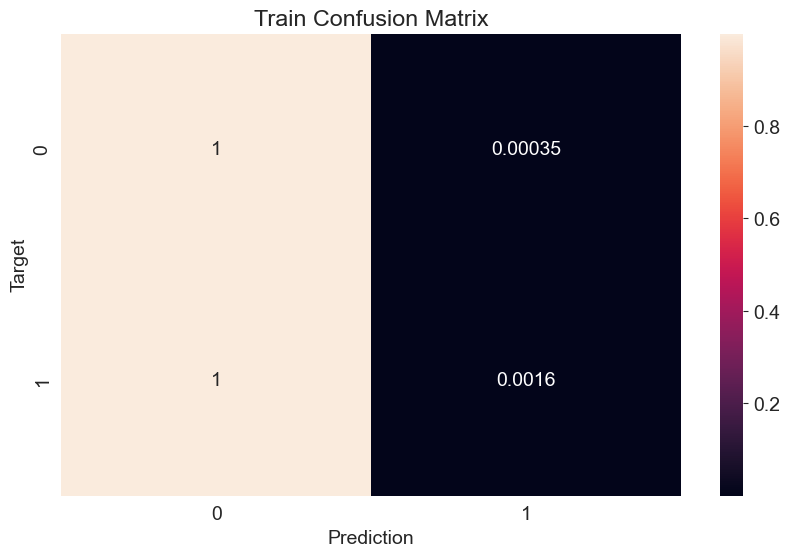

In [62]:
%%time
train_preds=predict_and_plot(train_inputs, train_targets,'Train')

Accuracy: 87.50%
CPU times: total: 141 ms
Wall time: 188 ms


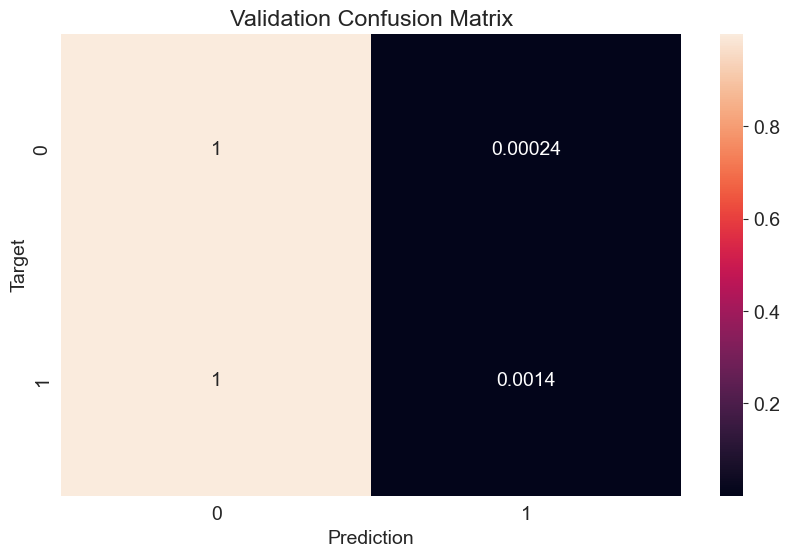

In [63]:
%%time
val_preds=predict_and_plot(val_inputs, val_targets,'Validation')

##### Evaluate: Logistic Regression Model 

Training Accuracy - 87.79%

Validation Accuracy - 87.50%

### Random Forest Classifier

In [64]:
from sklearn.ensemble import RandomForestClassifier

In [65]:
model_2=RandomForestClassifier(n_jobs=-1, random_state=42)

In [66]:
model_2.fit(train_inputs, train_targets)

RandomForestClassifier(n_jobs=-1, random_state=42)

In [67]:
%%time
model_2.score(train_inputs, train_targets)

CPU times: total: 13.4 s
Wall time: 4.89 s


0.9998622440445148

In [68]:
from sklearn.metrics import confusion_matrix
def predict_and_plot_2(inputs, targets,name=''):
    preds=model_2.predict(inputs)
    accuracy = accuracy_score(targets, preds)
    print("Accuracy: {:.2f}%".format(accuracy * 100))
    cf = confusion_matrix(targets, preds, normalize='true')
    plt.figure()
    sns.heatmap(cf, annot=True)
    plt.xlabel('Prediction')
    plt.ylabel('Target')
    plt.title('{} Confusion Matrix'.format(name));    
    return preds

Accuracy: 86.50%
CPU times: total: 3.44 s
Wall time: 1.28 s


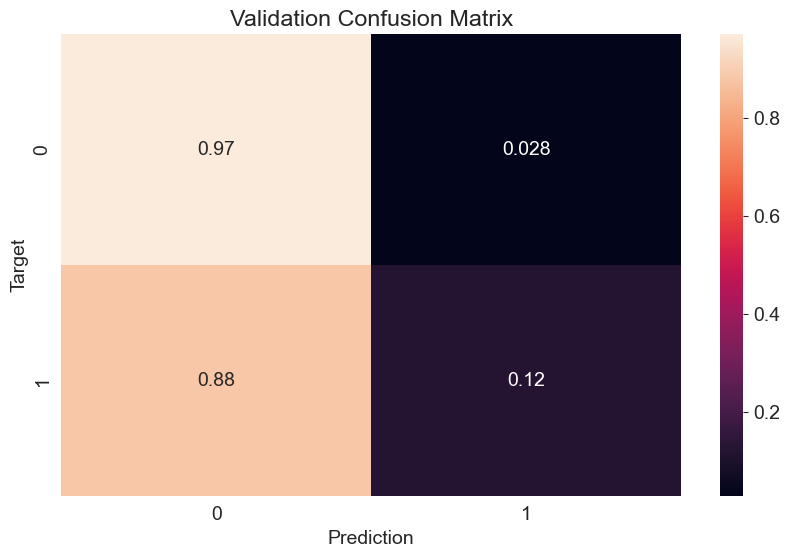

In [69]:
%%time
val_preds_2 = predict_and_plot_2(val_inputs, val_targets, 'Validation')

Evaluate: Random forest without hyperparameter turning
Training Accuracy - 0.9998622440445148%

Validation Accuracy - 86.50%

This model seems to be overfitting as training accuracy is very high and the validation accuracy is not so.

#### Hyperparameter Tuning of Random Forest

In [70]:
model_2.feature_importances_

array([0.01377792, 0.14299035, 0.00052909, 0.10698464, 0.04813046,
       0.01911754, 0.07683715, 0.24981284, 0.06238414, 0.27943588])

In [71]:
importance_df=pd.DataFrame({
    'feature':train_inputs.columns,
    'importance':model_2.feature_importances_
}).sort_values('importance',ascending=False)

In [72]:
importance_df

,feature,importance
9,Vintage,0.279436
7,Annual_Premium,0.249813
1,Age,0.142990
3,Region_Code,0.106985
6,Vehicle_Damage,0.076837
8,Policy_Sales_Channel,0.062384
4,Previously_Insured,0.048130
5,Vehicle_Age,0.019118
0,Gender,0.013778
2,Driving_License,0.000529


##### Testing for n_estimators hyperparameter

In [73]:
model_2_1_1 = RandomForestClassifier(random_state=42,n_jobs=-1,n_estimators = 10)

In [74]:
model_2_1_1.fit(train_inputs,train_targets)

RandomForestClassifier(n_estimators=10, n_jobs=-1, random_state=42)

In [75]:
%%time
model_2_1_1.score(train_inputs, train_targets)

CPU times: total: 1.27 s
Wall time: 522 ms


0.986667191451259

In [76]:
%%time
model_2_1_1.score(val_inputs, val_targets)

CPU times: total: 328 ms
Wall time: 156 ms


0.8618509091863241

In [77]:
%%time
model_2_1_2 = RandomForestClassifier(random_state=42,n_jobs=-1,n_estimators = 20)
model_2_1_2.fit(train_inputs,train_targets)
print("Training Accuracy = ",model_2_1_2.score(train_inputs, train_targets))
print("Validation Accuracy = ",model_2_1_2.score(val_inputs, val_targets))      

Training Accuracy =  0.9956410079800057
Validation Accuracy =  0.8631497467922647
CPU times: total: 16.6 s
Wall time: 6.33 s


In [78]:
%%time
model_2_1_3 = RandomForestClassifier(random_state=42,n_jobs=-1,n_estimators = 100)
model_2_1_3.fit(train_inputs,train_targets)
print("Training Accuracy = ",model_2_1_3.score(train_inputs, train_targets))
print("Validation Accuracy = ",model_2_1_3.score(val_inputs, val_targets))

Training Accuracy =  0.9998622440445148
Validation Accuracy =  0.8649733672692923
CPU times: total: 1min 19s
Wall time: 29.1 s


In [79]:
%%time
model_2_1_4 = RandomForestClassifier(random_state=42,n_jobs=-1,n_estimators = 200)
model_2_1_4.fit(train_inputs,train_targets)
print("Training Accuracy = ",model_2_1_4.score(train_inputs, train_targets))
print("Validation Accuracy = ",model_2_1_4.score(val_inputs, val_targets))

Training Accuracy =  0.9998852033704291
Validation Accuracy =  0.864802812836189
CPU times: total: 2min 41s
Wall time: 57.2 s


Maybe best value=100

##### Testing for max__features hyperparameter

In [80]:
%%time
model_2_2_1 = RandomForestClassifier(random_state=42,n_jobs=-1,max_features = 2)
model_2_2_1.fit(train_inputs,train_targets)
print("Training Accuracy = ",model_2_2_1.score(train_inputs, train_targets))
print("Validation Accuracy = ",model_2_2_1.score(val_inputs, val_targets))      

Training Accuracy =  0.9998524043334087
Validation Accuracy =  0.8648684106950749
CPU times: total: 1min 7s
Wall time: 25.1 s


In [81]:
%%time
model_2_2_2 = RandomForestClassifier(random_state=42,n_jobs=-1,max_features = 10)
model_2_2_2.fit(train_inputs,train_targets)
print("Training Accuracy = ",model_2_2_2.score(train_inputs, train_targets))
print("Validation Accuracy = ",model_2_2_2.score(val_inputs, val_targets))   

KeyboardInterrupt: 

In [82]:
%%time
model_2_2_3 = RandomForestClassifier(random_state=42,n_jobs=-1,max_features = 6)
model_2_2_3.fit(train_inputs,train_targets)
print("Training Accuracy = ",model_2_2_3.score(train_inputs, train_targets))
print("Validation Accuracy = ",model_2_2_3.score(val_inputs, val_targets)) 

KeyboardInterrupt: 

Maybe best value=6

##### Using all best parameters

In [83]:
model_2_all = RandomForestClassifier(n_jobs=-1, 
                               random_state=42, 
                               n_estimators=100,
                               max_features=6)

In [85]:
model_2_all.fit(train_inputs,train_targets)
print("Training Accuracy = ",model_2_all.score(train_inputs, train_targets))
print("Validation Accuracy = ",model_2_all.score(val_inputs, val_targets)) 

Training Accuracy =  0.9998556842371108
Validation Accuracy =  0.8651832804177272


Not much change was observed by changing and tuning these hyperparameters.

### Decision Tree Classifier

In [86]:
from sklearn.tree import DecisionTreeClassifier

In [87]:
model_3=DecisionTreeClassifier(random_state=42)

In [88]:
model_3.fit(train_inputs, train_targets)

DecisionTreeClassifier(random_state=42)

In [89]:
%%time
train_preds_3=model_3.predict(train_inputs)
train_probs_3=model_3.predict_proba(train_inputs)
accuracy_score(train_targets, train_preds_3)

CPU times: total: 328 ms
Wall time: 922 ms


0.9998852033704291

In [90]:
def predict_and_plot_3(inputs, targets, name=''):
    preds = model_3.predict(inputs)
    accuracy = accuracy_score(targets, preds)
    print("Accuracy: {:.2f}%".format(accuracy * 100))
    cf = confusion_matrix(targets, preds, normalize='true')
    plt.figure()
    sns.heatmap(cf, annot=True)
    plt.xlabel('Prediction')
    plt.ylabel('Target')
    plt.title('{} Confusion Matrix'.format(name));    
    return preds

Accuracy: 86.50%
CPU times: total: 2.98 s
Wall time: 1e+03 ms


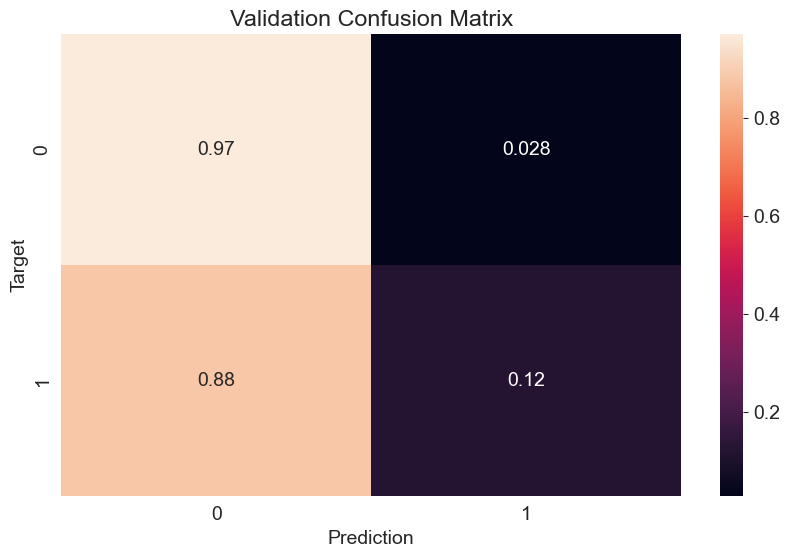

In [92]:
%%time
val_preds = predict_and_plot_2(val_inputs, val_targets, 'Validation')

##### Decision Tree Model without hyperparameter tuning:

Training Accuracy - 99.98852033704291%

Validation Accuracy - 82.18%

##### Visualization

In [93]:
from sklearn.tree import plot_tree, export_text

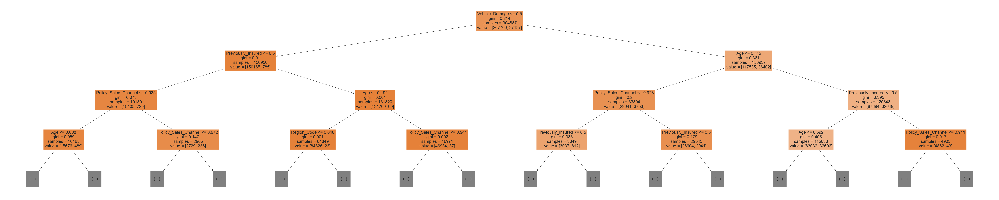

In [94]:
plt.figure(figsize=(100,20))
plot_tree(model_3, feature_names=train_inputs.columns, max_depth=3, filled=True);

In [95]:
model_3_text=export_text(model_3, feature_names=list(train_inputs.columns))
print(model_3_text[:3000])

|--- Vehicle_Damage <= 0.50
|   |--- Previously_Insured <= 0.50
|   |   |--- Policy_Sales_Channel <= 0.94
|   |   |   |--- Age <= 0.61
|   |   |   |   |--- Policy_Sales_Channel <= 0.92
|   |   |   |   |   |--- Age <= 0.30
|   |   |   |   |   |   |--- Policy_Sales_Channel <= 0.75
|   |   |   |   |   |   |   |--- Region_Code <= 0.99
|   |   |   |   |   |   |   |   |--- Annual_Premium <= 0.20
|   |   |   |   |   |   |   |   |   |--- Age <= 0.05
|   |   |   |   |   |   |   |   |   |   |--- Vintage <= 0.90
|   |   |   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |   |   |   |--- Vintage >  0.90
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 2
|   |   |   |   |   |   |   |   |   |--- Age >  0.05
|   |   |   |   |   |   |   |   |   |   |--- Vintage <= 0.71
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 16
|   |   |   |   |   |   |   |   |   |   |--- Vintage >  0.71
|   |   |   |   |   |   |   |   |   |   |   

In [96]:
model_3.feature_importances_

array([0.02497463, 0.13148203, 0.00057645, 0.10268734, 0.01257527,
       0.00940411, 0.12491632, 0.27135783, 0.04471703, 0.277309  ])

In [97]:
importance_df = pd.DataFrame({
    'feature': train_inputs.columns,
    'importance': model_3.feature_importances_
}).sort_values('importance', ascending=False)

In [98]:
importance_df

,feature,importance
9,Vintage,0.277309
7,Annual_Premium,0.271358
1,Age,0.131482
6,Vehicle_Damage,0.124916
3,Region_Code,0.102687
8,Policy_Sales_Channel,0.044717
0,Gender,0.024975
4,Previously_Insured,0.012575
5,Vehicle_Age,0.009404
2,Driving_License,0.000576


#### Hyperparameter Tuning of Random Forest

##### Testing for max_leaf_nodes hyperparameter

In [99]:
from sklearn.model_selection import GridSearchCV

In [100]:
params_grid = {
    'max_leaf_nodes':[5,10,15,20,25]
}

In [101]:
grid = GridSearchCV(estimator=DecisionTreeClassifier(random_state=42),cv=5,param_grid=params_grid)

In [102]:
grid.fit(train_inputs,train_targets)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'max_leaf_nodes': [5, 10, 15, 20, 25]})

In [103]:
grid.best_params_

{'max_leaf_nodes': 5}

In [104]:
model_3_1=grid.best_estimator_

In [105]:
model_3_1.score(train_inputs, train_targets)

0.8780302210327104

In [106]:
model_3_1.score(val_inputs, val_targets)

0.8750623179659416

##### Testing for max_depth hyperparameter

In [107]:
params_grid = {
    'max_depth':[10,20,30,40,50]
}

In [108]:
grid = GridSearchCV(estimator=DecisionTreeClassifier(random_state=42),cv=5,param_grid=params_grid)

In [109]:
grid.fit(train_inputs,train_targets)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'max_depth': [10, 20, 30, 40, 50]})

In [110]:
grid.best_params_

{'max_depth': 10}

In [111]:
model_3_2=grid.best_estimator_

In [112]:
model_3_2.score(train_inputs, train_targets)

0.8789092352248538

In [113]:
model_3_2.score(val_inputs, val_targets)

0.8742226653722023

##### Testing for criterion and splitter hyperparameter

In [114]:
params_grid = {
    'criterion':['gini','entropy'],
    'splitter':['best','random']
}

In [115]:
grid = GridSearchCV(estimator=DecisionTreeClassifier(random_state=42),cv=5,param_grid=params_grid)

In [116]:
grid.fit(train_inputs,train_targets)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'criterion': ['gini', 'entropy'],
                         'splitter': ['best', 'random']})

In [117]:
grid.best_params_

{'criterion': 'entropy', 'splitter': 'best'}

In [118]:
model_3_3=grid.best_estimator_

In [119]:
model_3_3.score(train_inputs, train_targets)

0.9998852033704291

In [120]:
model_3_3.score(val_inputs, val_targets)

0.8231219333000971

##### Using all the best parameters

In [121]:
model_3_all = DecisionTreeClassifier(random_state=42,
                                       criterion='entropy',
                                       splitter='best',
                                       max_leaf_nodes=5,
                                       max_depth=10)

In [122]:
model_3_all.fit(train_inputs, train_targets)

DecisionTreeClassifier(criterion='entropy', max_depth=10, max_leaf_nodes=5,
                       random_state=42)

In [123]:
model_3_all.score(train_inputs, train_targets)

0.8780302210327104

In [124]:
model_3_all.score(val_inputs, val_targets)

0.8750623179659416

##### Decision Tree with hyperparameter tuning:

Training Accuracy - 87.80302210327104%

Validation Accuracy - 87.50623179659416%

The training accuracy reduced but the validation accuracy improved significantly.

# Summary

##### Best Model - Decision Tree with Hyperparameter Tuning

Training Accuracy - 87.80302210327104%

Validation Accuracy - 87.50623179659416%

Data Set Link - https://www.kaggle.com/anmolkumar/health-insurance-cross-sell-prediction

##### Reference Notebooks: 
- https://jovian.ai/aakashns/python-sklearn-logistic-regression
- https://jovian.ai/aakashns/sklearn-decision-trees-random-forests
- https://jovian.ai/enjamurichandra2810/project

##### Future Possible Work :
- Betterment of results using different hyperparameters for tuning
- Implementing more models to gain better results
- Using the same method to predict response for various other kinds of insurances
- Combining all the processing of insurance offer advertisements and achieving the best customers for the same

